Initial total energy of the system: -45.912
Running simulation with 64 particles for 5000 steps...
Progress: 100.0% | Step: 5000/5000 | Time: 21.5s | ETA: 0.0s | T: 0.000 | P: 39.152
Simulation completed in 21.53 seconds


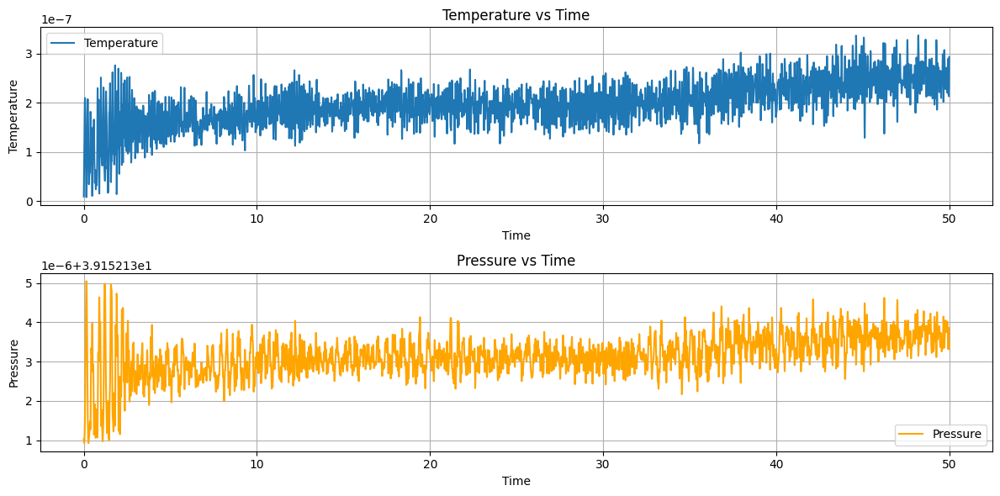

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import time
import sys

# Import the LJSimulator class
from LJSimulator import LJSimulator

# Set simulation parameters
N = 64               # Number of particles
Lx = 8.0             # Box dimension in x
Ly = np.sqrt(3) * Lx / 2  # Box dimension in y (triangular lattice)
temperature = 0.0    # Initial temperature (zero initial velocity)
dt = 0.01            # Time step
total_time = 50.0    # Total simulation time (units)
anim_interval = 5    # Save position every N steps for animation

# Derived parameters
num_steps = int(total_time / dt)

# Create the simulation
sim = LJSimulator(N=N, Lx=Lx, Ly=Ly, temperature=temperature, dt=dt,
                  lattice_type='triangular', snapshot_interval=anim_interval)

# Set initial velocities to zero
sim.vx = np.zeros(N)
sim.vy = np.zeros(N)

# Calculate the total energy of the system
sim.compute_energy()
total_energy = sim.total_energy
print(f"Initial total energy of the system: {total_energy:.3f}")

# Run the simulation and measure temperature and pressure
print(f"Running simulation with {N} particles for {num_steps} steps...")
start_time = time.time()

temperatures = []
pressures = []
times = []

for i in range(num_steps):
    sim.step()

    # Record temperature and pressure
    temperatures.append(sim.temperature)
    pressures.append(sim.pressure)
    times.append(i * dt)

    # Print progress updates
    if (i+1) % (num_steps // 20) == 0 or i == num_steps-1:
        progress = (i+1) / num_steps * 100
        elapsed = time.time() - start_time
        eta = elapsed / (i+1) * (num_steps - i - 1)

        sys.stdout.write(f"\rProgress: {progress:.1f}% | Step: {i+1}/{num_steps} | ")
        sys.stdout.write(f"Time: {elapsed:.1f}s | ETA: {eta:.1f}s | ")
        sys.stdout.write(f"T: {sim.temperature:.3f} | P: {sim.pressure:.3f}")
        sys.stdout.flush()

print(f"\nSimulation completed in {time.time() - start_time:.2f} seconds")

# Plot temperature and pressure as a function of time
plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
plt.plot(times, temperatures, label='Temperature')
plt.xlabel('Time')
plt.ylabel('Temperature')
plt.title('Temperature vs Time')
plt.grid()
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(times, pressures, label='Pressure', color='orange')
plt.xlabel('Time')
plt.ylabel('Pressure')
plt.title('Pressure vs Time')
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()

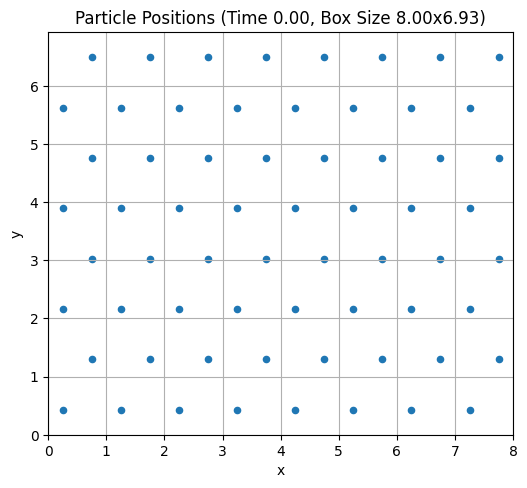

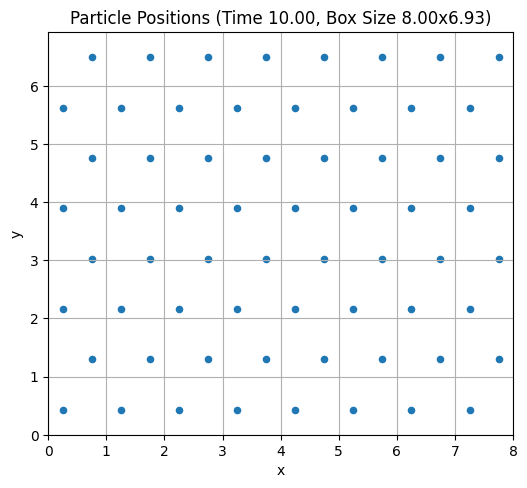

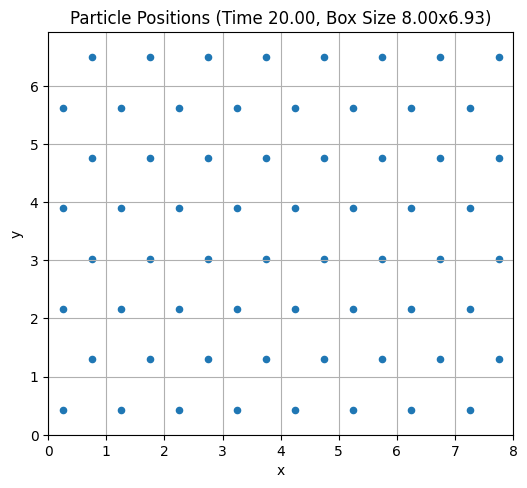

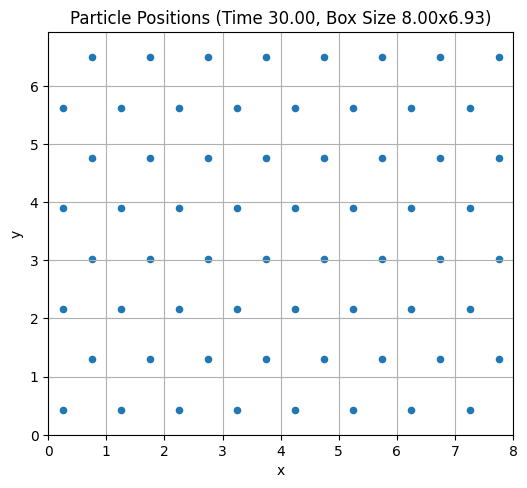

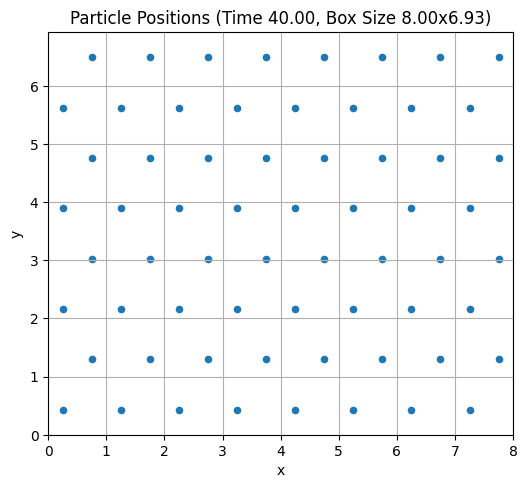

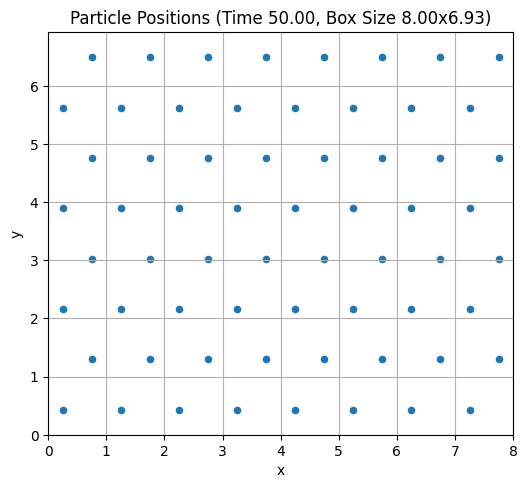

In [2]:
from LJVisualizer import LJVisualizer

# Create a visualizer object
viz = LJVisualizer(sim)

viz.plot_positions(time=0.0)
viz.plot_positions(time=10.0)
viz.plot_positions(time=20.0)
viz.plot_positions(time=30.0)
viz.plot_positions(time=40.0)
viz.plot_positions(time=50.0)

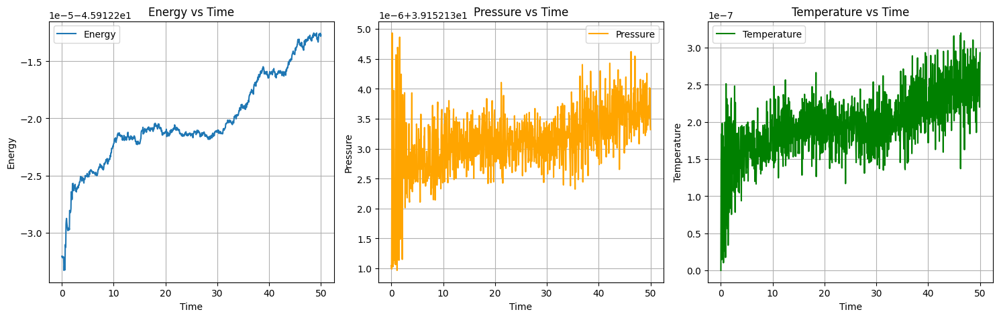

In [3]:
viz.plot_metrics()

In [4]:
viz.animate_positions()

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import time
import sys

# Import the LJSimulator class
from LJSimulator import LJSimulator

# Set simulation parameters
N = 64               # Number of particles
Lx = 8.0             # Box dimension in x
Ly = np.sqrt(3) * Lx / 2  # Box dimension in y (triangular lattice)
temperature = 0.0    # Initial temperature (zero initial velocity)
dt = 0.01            # Time step
total_time = 50.0    # Total simulation time (units)
anim_interval = 5    # Save position every N steps for animation

# Derived parameters
num_steps = int(total_time / dt)

# Create the simulation
sim = LJSimulator(N=N, Lx=Lx, Ly=Ly, temperature=temperature, dt=dt,
                  lattice_type='triangular', snapshot_interval=anim_interval)

# Set initial velocities randomly between -0.5 and 0.5
sim.vx = np.random.uniform(-0.5, 0.5, N)
sim.vy = np.random.uniform(-0.5, 0.5, N)

# Calculate the total energy of the system
sim.compute_energy()
total_energy = sim.total_energy
print(f"Initial total energy of the system: {total_energy:.3f}")

# Run the simulation and measure temperature and pressure
print(f"Running simulation with {N} particles for {num_steps} steps...")
start_time = time.time()

temperatures = []
pressures = []
times = []

for i in range(num_steps):
    sim.step()

    # Record temperature and pressure
    temperatures.append(sim.temperature)
    pressures.append(sim.pressure)
    times.append(i * dt)

    # Print progress updates
    if (i+1) % (num_steps // 20) == 0 or i == num_steps-1:
        progress = (i+1) / num_steps * 100
        elapsed = time.time() - start_time
        eta = elapsed / (i+1) * (num_steps - i - 1)

        sys.stdout.write(f"\rProgress: {progress:.1f}% | Step: {i+1}/{num_steps} | ")
        sys.stdout.write(f"Time: {elapsed:.1f}s | ETA: {eta:.1f}s | ")
        sys.stdout.write(f"T: {sim.temperature:.3f} | P: {sim.pressure:.3f}")
        sys.stdout.flush()

print(f"\nSimulation completed in {time.time() - start_time:.2f} seconds")

Initial total energy of the system: -40.359
Running simulation with 64 particles for 5000 steps...
Progress: 100.0% | Step: 5000/5000 | Time: 21.5s | ETA: 0.0s | T: 0.043 | P: 39.567
Simulation completed in 21.47 seconds


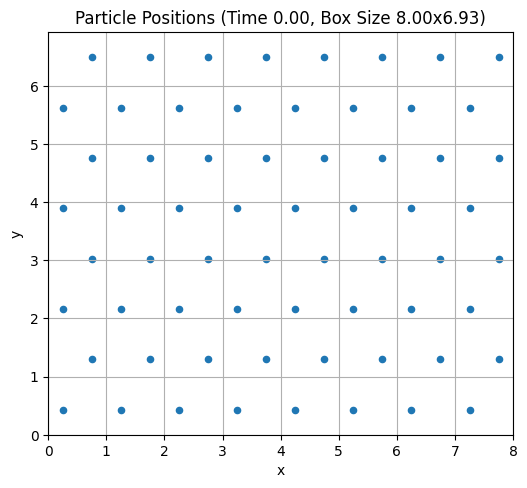

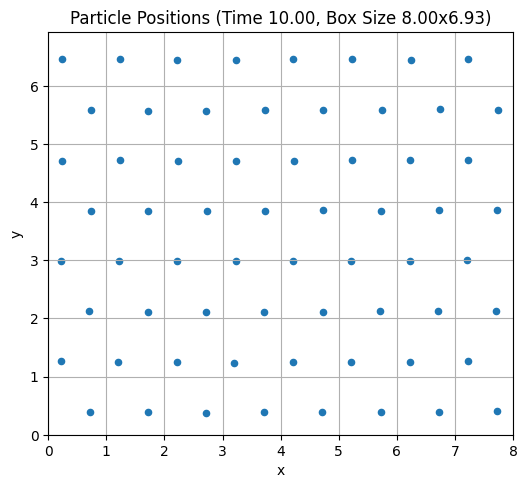

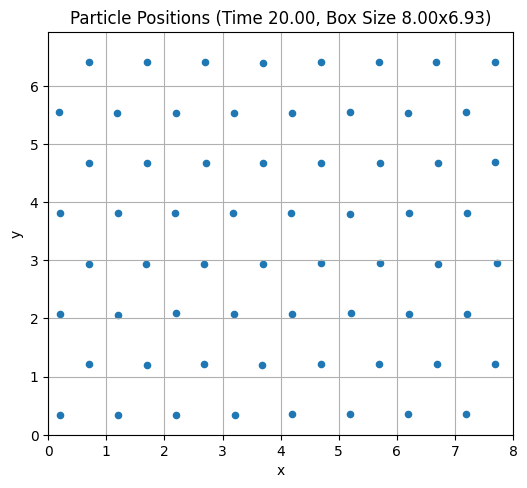

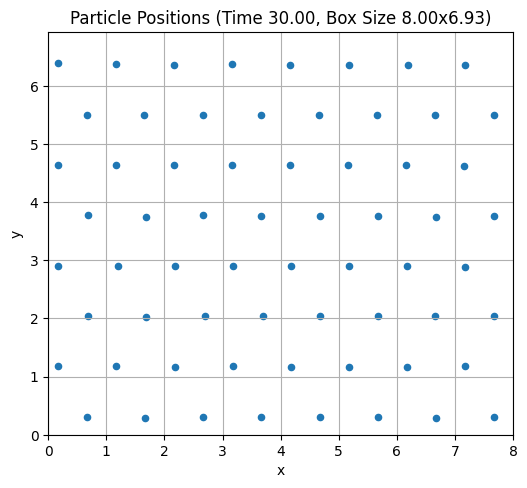

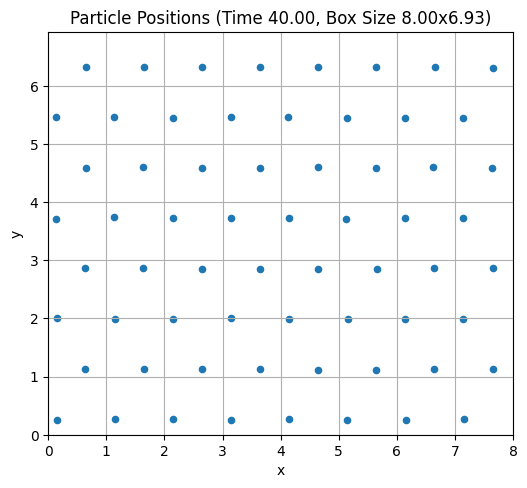

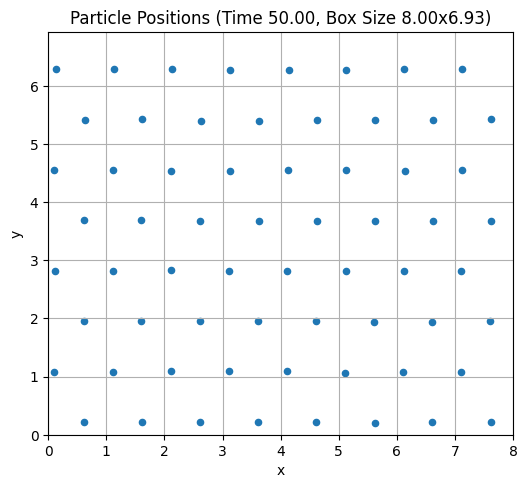

In [6]:
from LJVisualizer import LJVisualizer

# Create a visualizer object
viz = LJVisualizer(sim)

viz.plot_positions(time=0.0)
viz.plot_positions(time=10.0)
viz.plot_positions(time=20.0)
viz.plot_positions(time=30.0)
viz.plot_positions(time=40.0)
viz.plot_positions(time=50.0)

In [7]:
viz.animate_positions()

Animation size has reached 20977464 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [8]:
mean_temperature = np.mean(temperatures)
mean_pressure = np.mean(pressures)

print(f"Mean Temperature: {mean_temperature:.3f}")
print(f"Mean Pressure: {mean_pressure:.3f}")

Mean Temperature: 0.044
Mean Pressure: 39.560


In [9]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import time
import sys

# Import the LJSimulator class
from LJSimulator import LJSimulator

# Set simulation parameters
N = 64               # Number of particles
Lx = 8.0             # Box dimension in x
Ly = np.sqrt(3) * Lx / 2  # Box dimension in y (triangular lattice)
temperature = 0.0    # Initial temperature (zero initial velocity)
dt = 0.01            # Time step
total_time = 50.0    # Total simulation time (units)
anim_interval = 5    # Save position every N steps for animation

# Derived parameters
num_steps = int(total_time / dt)

# Create the simulation
sim = LJSimulator(N=N, Lx=Lx, Ly=Ly, temperature=temperature, dt=dt,
                  lattice_type='triangular', snapshot_interval=anim_interval)

# Set initial velocities randomly between -0.5 and 0.5
sim.vx = np.random.uniform(-0.5, 0.5, N)
sim.vy = np.random.uniform(-0.5, 0.5, N)

# Calculate the total energy of the system
sim.compute_energy()
total_energy = sim.total_energy
print(f"Initial total energy of the system: {total_energy:.3f}")

# Run the simulation and measure temperature and pressure
print(f"Running simulation with {N} particles for {num_steps} steps...")
start_time = time.time()

temperatures = []
pressures = []
times = []

for i in range(num_steps):
    sim.step()

    # Record temperature and pressure
    temperatures.append(sim.temperature)
    pressures.append(sim.pressure)
    times.append(i * dt)

    # Print progress updates
    if (i+1) % (num_steps // 20) == 0 or i == num_steps-1:
        progress = (i+1) / num_steps * 100
        elapsed = time.time() - start_time
        eta = elapsed / (i+1) * (num_steps - i - 1)

        sys.stdout.write(f"\rProgress: {progress:.1f}% | Step: {i+1}/{num_steps} | ")
        sys.stdout.write(f"Time: {elapsed:.1f}s | ETA: {eta:.1f}s | ")
        sys.stdout.write(f"T: {sim.temperature:.3f} | P: {sim.pressure:.3f}")
        sys.stdout.flush()

print(f"\nSimulation completed in {time.time() - start_time:.2f} seconds")

Initial total energy of the system: -40.608
Running simulation with 64 particles for 5000 steps...
Progress: 100.0% | Step: 5000/5000 | Time: 21.5s | ETA: 0.0s | T: 0.037 | P: 39.575
Simulation completed in 21.49 seconds


Ground state energy E(0): -45.2722
T=0.050, E=-39.402, E(T)-E(0)=5.871, P=39.626
T=0.276, E=-10.133, E(T)-E(0)=35.139, P=41.747
T=0.661, E=39.063, E(T)-E(0)=84.335, P=45.281
T=1.090, E=93.689, E(T)-E(0)=138.961, P=49.154
T=1.467, E=140.729, E(T)-E(0)=186.002, P=52.482
T=2.046, E=213.065, E(T)-E(0)=258.338, P=57.513
T=2.555, E=276.045, E(T)-E(0)=321.317, P=61.950


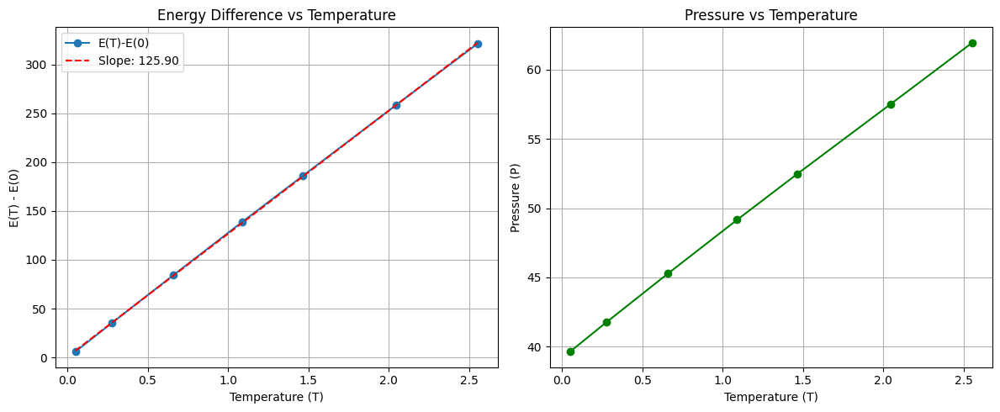

Heat capacity (from slope): 125.90
Expected heat capacity for 2D harmonic solid (2N): 128


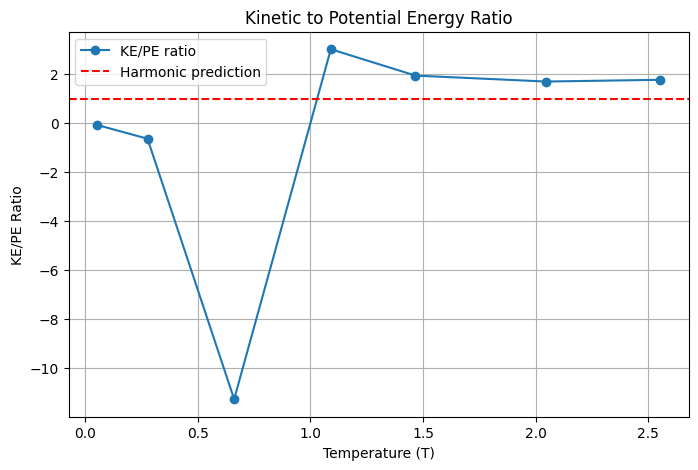


Analysis for Problem 8.11(d):
1. Is E(T)-E(0) proportional to T? Yes
2. Mean potential energy for harmonic solid: Equal to kinetic energy (ratio=1)
3. Heat capacity for this system: 125.90


In [10]:
# Problem 8.11(d) Solution - Simple version for Jupyter cell

import numpy as np
import matplotlib.pyplot as plt
from LJSimulator import LJSimulator

# Initialize simulator with triangular lattice as specified in Problem 8.11
N = 64
Lx = 8
Ly = np.sqrt(3) * Lx / 2
sim = LJSimulator(N=N, Lx=Lx, Ly=Ly, temperature=0.01, lattice_type='triangular')

# Record initial energy (ground state energy)
E0 = sim.total_energy
print(f"Ground state energy E(0): {E0:.4f}")

# Define temperature range
temperatures = [0.1, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0]
results = {
    'T': [],                # Temperature
    'E': [],                # Total energy
    'E_diff': [],           # E(T) - E(0)
    'P': [],                # Pressure
    'KE': [],               # Kinetic energy
    'PE': []                # Potential energy
}

# For each temperature
for target_T in temperatures:
    # Set temperature
    sim.set_temperature(target_T)

    # Equilibrate system
    for _ in range(1000):
        sim.step()

    # Reset accumulators for measurement
    sim.clear_history()

    # Measure
    for _ in range(500):
        sim.step()

    # Calculate averages
    avg_T = np.mean(sim.temperature_history[-200:])
    avg_E = np.mean([s['total_energy'] for s in sim.snapshots[-5:]])
    avg_P = np.mean(sim.pressure_history[-200:])
    avg_KE = np.mean([s['kinetic_energy'] for s in sim.snapshots[-5:]])
    avg_PE = np.mean([s['potential_energy'] for s in sim.snapshots[-5:]])

    # Store results
    results['T'].append(avg_T)
    results['E'].append(avg_E)
    results['E_diff'].append(avg_E - E0)
    results['P'].append(avg_P)
    results['KE'].append(avg_KE)
    results['PE'].append(avg_PE)

    print(f"T={avg_T:.3f}, E={avg_E:.3f}, E(T)-E(0)={avg_E-E0:.3f}, P={avg_P:.3f}")

# Convert to arrays for easier plotting
T_array = np.array(results['T'])
E_diff_array = np.array(results['E_diff'])
P_array = np.array(results['P'])

# Plot E(T)-E(0) vs T
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(T_array, E_diff_array, 'o-', label='E(T)-E(0)')

# Linear fit to check proportionality
coeffs = np.polyfit(T_array, E_diff_array, 1)
linear_fit = coeffs[0] * T_array + coeffs[1]
plt.plot(T_array, linear_fit, '--r',
         label=f'Slope: {coeffs[0]:.2f}')

plt.xlabel('Temperature (T)')
plt.ylabel('E(T) - E(0)')
plt.title('Energy Difference vs Temperature')
plt.grid(True)
plt.legend()

# Plot P(T) vs T
plt.subplot(1, 2, 2)
plt.plot(T_array, P_array, 'o-g')
plt.xlabel('Temperature (T)')
plt.ylabel('Pressure (P)')
plt.title('Pressure vs Temperature')
plt.grid(True)

plt.tight_layout()
plt.show()

# Calculate heat capacity from the slope
heat_capacity = coeffs[0]  # Since C_V = d(E-E0)/dT
print(f"Heat capacity (from slope): {heat_capacity:.2f}")
print(f"Expected heat capacity for 2D harmonic solid (2N): {2*N}")

# Check equipartition (KE/PE ratio)
KE_array = np.array(results['KE'])
PE_array = np.array(results['PE'])
ratio = KE_array / PE_array

plt.figure(figsize=(8, 5))
plt.plot(T_array, ratio, 'o-', label='KE/PE ratio')
plt.axhline(y=1.0, linestyle='--', color='red', label='Harmonic prediction')
plt.xlabel('Temperature (T)')
plt.ylabel('KE/PE Ratio')
plt.title('Kinetic to Potential Energy Ratio')
plt.grid(True)
plt.legend()
plt.show()

print("\nAnalysis for Problem 8.11(d):")
print("1. Is E(T)-E(0) proportional to T?",
      "Yes" if np.abs(coeffs[1]/np.max(E_diff_array)) < 0.1 else "No")
print("2. Mean potential energy for harmonic solid: Equal to kinetic energy (ratio=1)")
print("3. Heat capacity for this system:", f"{heat_capacity:.2f}")

Equilibrating initial configuration...


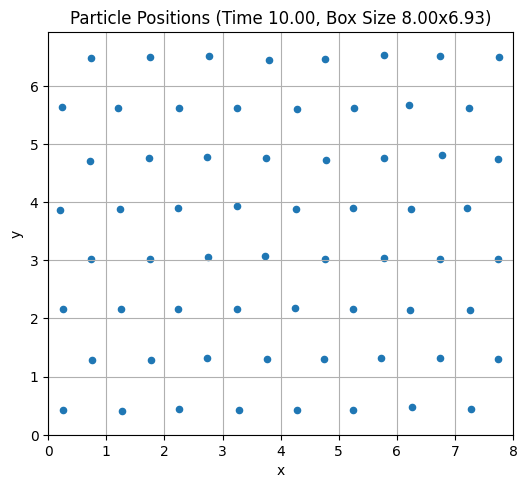

Initial state: Density=1.1547, P=41.5224, T=0.2504

Rescaling box and positions by factor of 1.1
Equilibrating at scaling factor 1.1...
Equilibrating at scaling factor 1.2...

*** Possible melting detected at scale=1.2, density=0.8019 ***
    Pressure dropped from 2.6624 to -2.7642


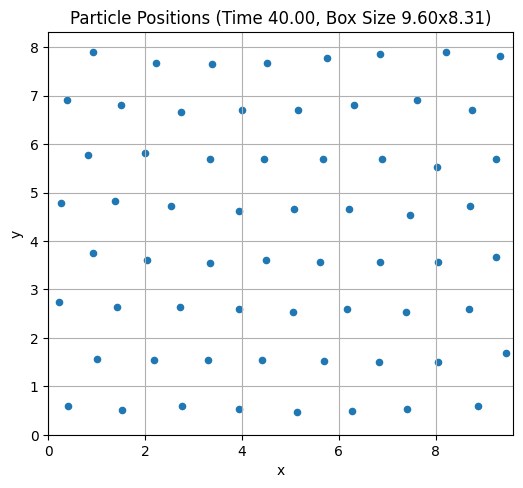

Equilibrating at scaling factor 1.3...


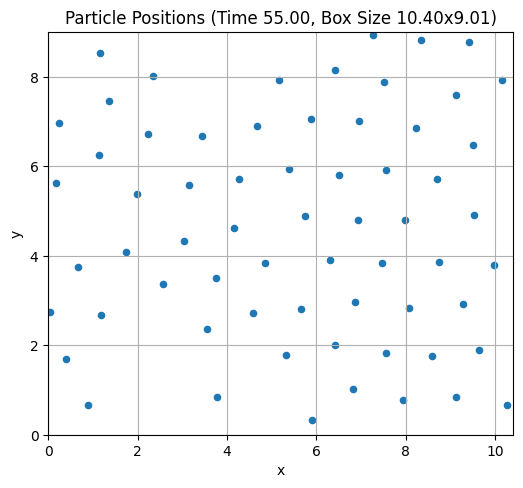

Scale=1.3, Density=0.6833, P=-0.1995, T=0.3418
Equilibrating at scaling factor 1.4...

*** Possible melting detected at scale=1.4, density=0.5891 ***
    Pressure dropped from -0.1995 to -0.1847


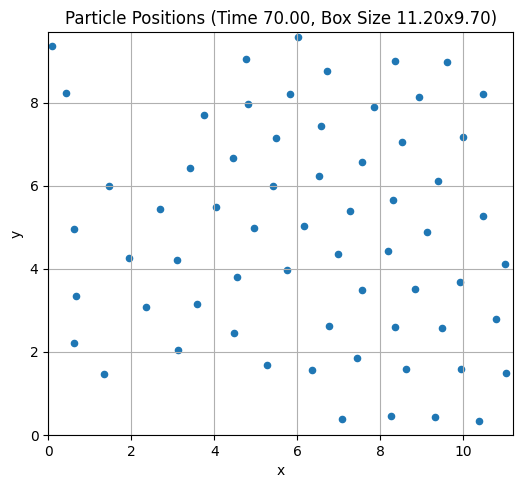

Equilibrating at scaling factor 1.5...

*** Possible melting detected at scale=1.5, density=0.5132 ***
    Pressure dropped from -0.1847 to -0.1014


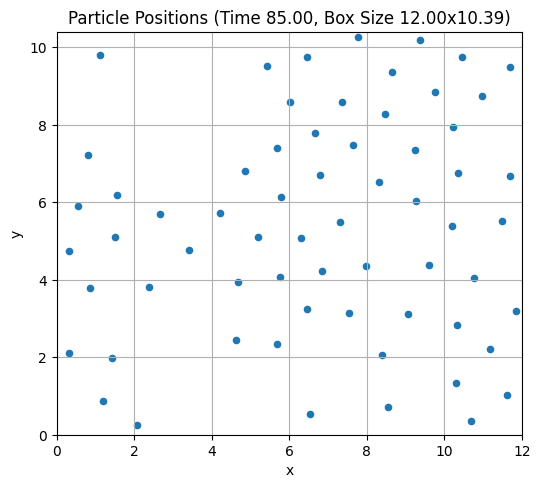

Equilibrating at scaling factor 1.6...


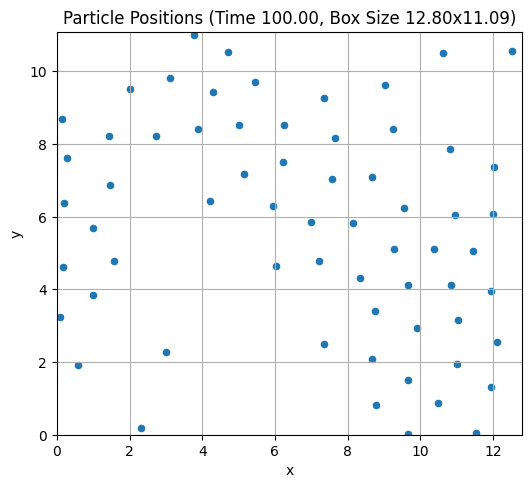

Scale=1.6, Density=0.4511, P=0.1789, T=0.5473
Equilibrating at scaling factor 1.7...

*** Possible melting detected at scale=1.7, density=0.3996 ***
    Pressure dropped from 0.1789 to -0.0446


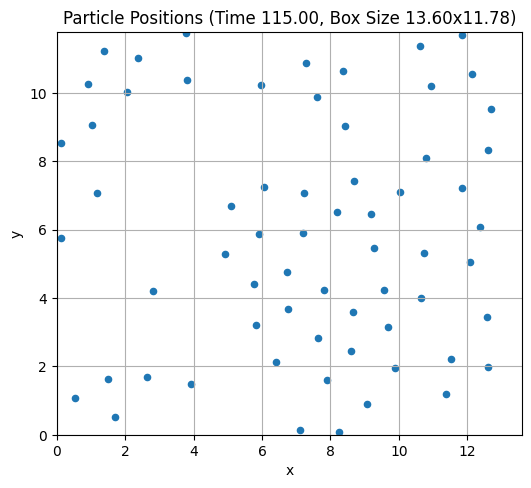

Equilibrating at scaling factor 1.8...
Equilibrating at scaling factor 1.9...


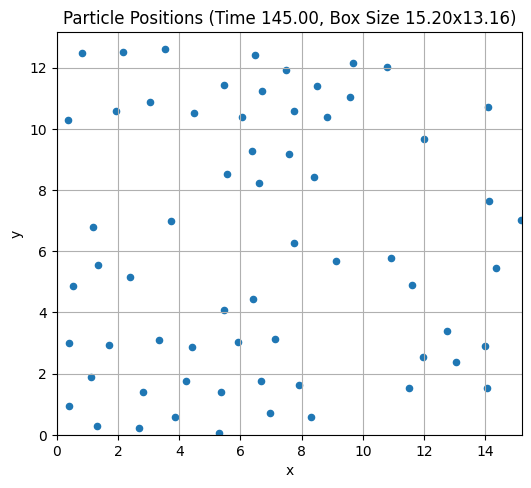

Scale=1.9, Density=0.3199, P=0.0603, T=0.5750
Equilibrating at scaling factor 2.0...
Equilibrating at scaling factor 2.1...
Equilibrating at scaling factor 2.2...


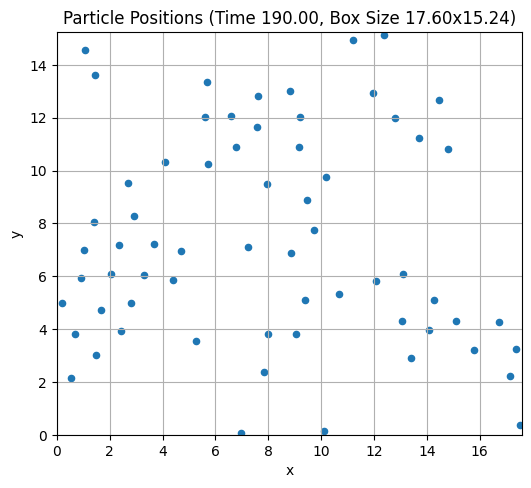

Scale=2.2, Density=0.2386, P=0.1052, T=0.6368
Equilibrating at scaling factor 2.3...

*** Possible melting detected at scale=2.3, density=0.2183 ***
    Pressure dropped from 0.1052 to 0.0492


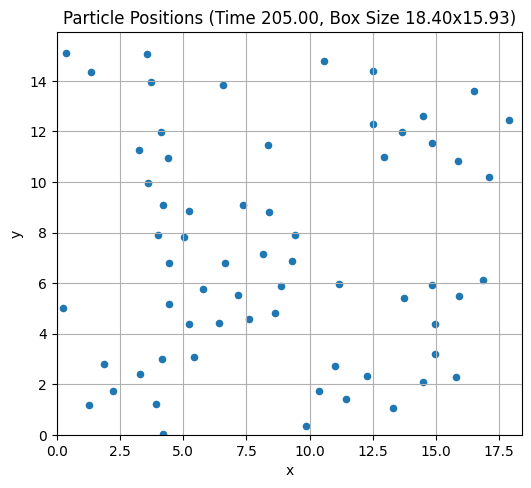

Equilibrating at scaling factor 2.4...


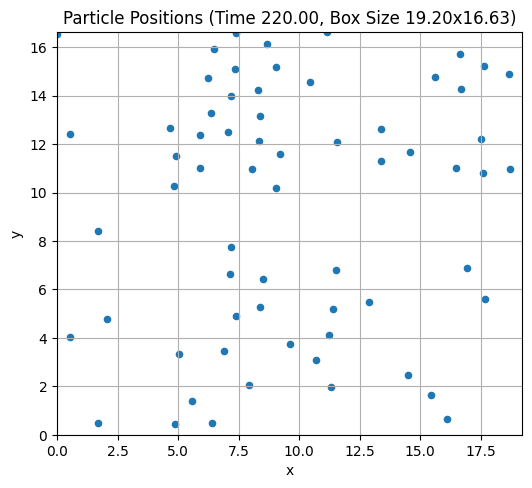

Scale=2.4, Density=0.2005, P=0.0696, T=0.6008


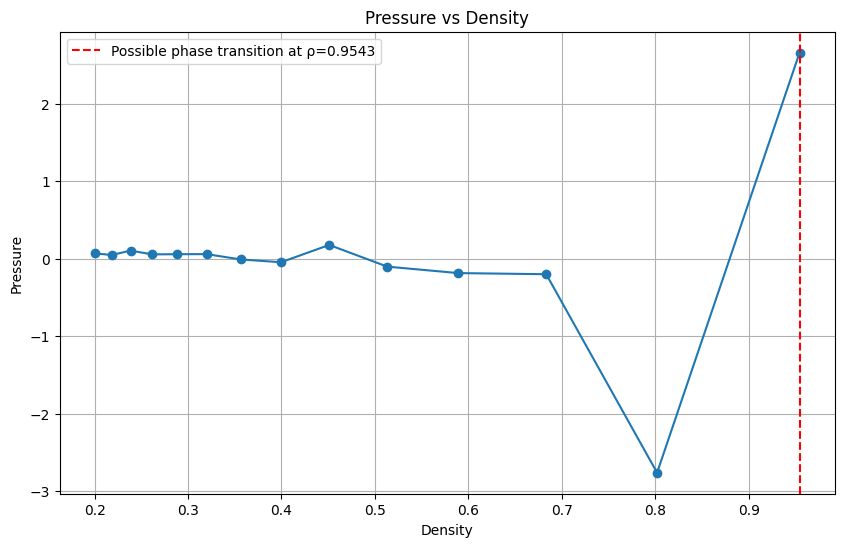


Qualitative criteria for melting:
1. Visual observation: particles are no longer localized near lattice sites
2. Sudden drop in pressure as density decreases
3. Increase in particle mobility/diffusion
4. Loss of long-range order in particle arrangement

Approximate melting density: 0.9543
Corresponding scale factor: 1.10


In [11]:
# Problem 8.11(e) Solution - Density reduction experiment

import numpy as np
import matplotlib.pyplot as plt
from LJSimulator import LJSimulator
from LJVisualizer import LJVisualizer

# Initialize simulator with triangular lattice as in part (b)
N = 64
Lx = 8
Ly = np.sqrt(3) * Lx / 2
sim = LJSimulator(N=N, Lx=Lx, Ly=Ly, temperature=0.5, lattice_type='triangular')

# Run to equilibrium (part b configuration)
print("Equilibrating initial configuration...")
for _ in range(1000):
    sim.step()

# Create visualizer for later use
viz = LJVisualizer(sim)

# Show initial configuration
viz.plot_positions()

# Collect metrics about initial state
msd_data = []  # Will store mean square displacement data
density_factors = [1.0]  # Start with current density
rdf_peaks = []  # Will track highest peak in radial distribution function (if implemented)

# Calculate initial metrics
initial_pressure = np.mean(sim.pressure_history[-100:])
initial_temperature = np.mean(sim.temperature_history[-100:])
print(f"Initial state: Density={N/(Lx*Ly):.4f}, P={initial_pressure:.4f}, T={initial_temperature:.4f}")

# Scale box by factor of 1.1 as requested in the problem
scale_factor = 1.1
print(f"\nRescaling box and positions by factor of {scale_factor}")

# Loop for density rescaling with increasingly larger factors
max_scale = 2.5  # Maximum scaling to try
scale_values = np.arange(1.0, max_scale, 0.1)  # Scaling factors to try

results = []
for i, scale in enumerate(scale_values[1:], 1):  # Skip first value (1.0) as it's our baseline
    # Start from the initial equilibrated configuration each time
    sim.set_box_size(Lx * scale, Ly * scale)

    # Equilibrate at new density
    print(f"Equilibrating at scaling factor {scale:.1f}...")
    for _ in range(1000):
        sim.step()

    # Reset history for measurements
    sim.clear_history()

    # Measure at this density
    for _ in range(500):
        sim.step()

    # Calculate key metrics - will help determine phase
    avg_pressure = np.mean(sim.pressure_history[-200:])
    avg_temperature = np.mean(sim.temperature_history[-200:])
    density = N / (sim.Lx * sim.Ly)

    # Store results
    results.append({
        'scale_factor': scale,
        'density': density,
        'pressure': avg_pressure,
        'temperature': avg_temperature
    })

    # Plot current configuration
    if i % 3 == 0 or i == len(scale_values)-1:  # Only plot some configurations
        viz.plot_positions()
        print(f"Scale={scale:.1f}, Density={density:.4f}, P={avg_pressure:.4f}, T={avg_temperature:.4f}")

    # Qualitative criteria for melting:
    # 1. Sudden drop in pressure
    # 2. Visual inspection of particle arrangement
    # 3. Particles no longer localized near lattice sites
    # 4. Loss of long-range order in RDF (if implemented)

    # Check for pressure drop as indication of phase transition
    if i > 1 and avg_pressure < 0.5 * results[i-2]['pressure']:
        print(f"\n*** Possible melting detected at scale={scale:.1f}, density={density:.4f} ***")
        print(f"    Pressure dropped from {results[i-2]['pressure']:.4f} to {avg_pressure:.4f}")
        viz.plot_positions()

# Plot pressure vs density
densities = [r['density'] for r in results]
pressures = [r['pressure'] for r in results]

plt.figure(figsize=(10, 6))
plt.plot(densities, pressures, 'o-')
plt.xlabel('Density')
plt.ylabel('Pressure')
plt.title('Pressure vs Density')
plt.grid(True)

# Add annotation for possible phase transition (largest pressure drop)
pressure_drops = [pressures[i] - pressures[i+1] for i in range(len(pressures)-1)]
if pressure_drops:
    max_drop_idx = np.argmax(pressure_drops)
    plt.axvline(x=densities[max_drop_idx], color='r', linestyle='--',
                label=f'Possible phase transition at ρ={densities[max_drop_idx]:.4f}')
    plt.legend()

plt.show()

# Summary report
print("\nQualitative criteria for melting:")
print("1. Visual observation: particles are no longer localized near lattice sites")
print("2. Sudden drop in pressure as density decreases")
print("3. Increase in particle mobility/diffusion")
print("4. Loss of long-range order in particle arrangement")

# Identify the approximate density where melting occurred (largest pressure drop)
if pressure_drops:
    melting_idx = np.argmax(pressure_drops)
    print(f"\nApproximate melting density: {densities[melting_idx]:.4f}")
    print(f"Corresponding scale factor: {results[melting_idx]['scale_factor']:.2f}")